In [1]:
from astropy.io import fits
import numpy as np
import matplotlib.pyplot as plt
import os
from matplotlib.colors import LogNorm
from astropy import wcs
import subprocess
import image_registration
from image_registration import chi2_shift
from image_registration.fft_tools import shift

In [2]:
import astroprov
from astropy.io import fits
from astropy.io.ascii import SExtractor
from astropy.coordinates import SkyCoord
import astropy.units as u

from photutils import DAOStarFinder
from photutils import CircularAperture

from astroquery.simbad import Simbad

from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
from astropy.table import Table
from astropy.table import Column

In [17]:
imageDirectory = '/data/mj1e16/kepler/cal/'
dirlist = os.listdir(imageDirectory)
dirlist = [x for x in dirlist if x[0] != '.']
#dirlist = sort(dirlist)
imagelist = [imageDirectory+x for x in dirlist]
#print(dirlist)

In [4]:
def correctExtensionOrder(imageName):
    hdu_list = fits.open(imageName)
    extensionOrder = np.zeros(len(hdu_list))
    for channel in range(1,len(hdu_list)):
        hdr = hdu_list[channel].header
        location = hdr['SKYGROUP'] # independant location
        extensionOrder[location] = channel # ordered from 0-84 channel with extension in place of name
    return extensionOrder

In [5]:
def medianImages(image1,image2,channelOrder1,channelOrder2,outfile): # medianing images 2 at a time as they are large
    image_concat = []
    medianlist = []
    hdu_list_1 = fits.open(image1)
    hdu_list_2 = fits.open(image2)
    for channel in range(1,len(channelOrder1)):
        chanNo1 = int(channelOrder1[channel])
        chanNo2 = int(channelOrder2[channel])
        
        im1 = hdu_list_1[chanNo1].data
        im2 = hdu_list_2[chanNo2].data
        
        yoff,xoff = image_registration.cross_correlation_shifts(im1,im2)
        im1_aligned_to_im2 = np.roll(np.roll(im1,int(yoff),1),int(xoff),0)

        medianImage = np.median([im2,im1_aligned_to_im2],axis=0)
        hdu = fits.PrimaryHDU(medianImage)
        hdu.writeto(outfile+'_{}.fits'.format(channel), clobber=True)
        medianlist.append(outfile+'_{}.fits'.format(channel))
    return outfile

In [6]:
def reMedian(median,image2,channel,channelOrder2,outfile): # medianing images 2 at a time as they are large
    
    image_concat = []
    hdu_list_1 = fits.open(median)
    hdu_list_2 = fits.open(image2)
    chanNo2 = int(channelOrder2[channel])
    im1 = hdu_list_1[0].data
    im2 = hdu_list_2[chanNo2].data
    
    yoff,xoff = image_registration.cross_correlation_shifts(im1,im2)
    im1_aligned_to_im2 = np.roll(np.roll(im1,int(yoff),1),int(xoff),0)
    
    medianImage = np.median([im2,im1_aligned_to_im2],axis=0)
    hdu = fits.PrimaryHDU(medianImage)
    hdu.writeto(outfile, clobber=True)
    
    return outfile

In [7]:
extensionOrders = []
for image in imagelist:
    extensionOrders.append(correctExtensionOrder(image))

In [26]:
medianDir = '/data/mj1e16/kepler/newDiff/'
medians = os.listdir(medianDir)
medians = [x for x in medians if x[0] != '.']
medians.sort()

In [67]:
medianImages(imagelist[0],imagelist[1],extensionOrders[0],extensionOrders[1],'/data/mj1e16/kepler/newDiff/median')

'/data/mj1e16/kepler/newDiff/median'

In [68]:
for imageNo in range(2,len(imagelist)):
    for channel in range(1,len(medians)):
        medianFile = medianDir+'median_{}.fits'.format(channel)
        reMedian(medianFile,imagelist[imageNo],channel,extensionOrders[imageNo],medianFile)

In [ ]:
os.chdir('/data/mj1e16/kepler/hotpants-master/')
for imNo in range(len(imagelist)):
    for channel in range(1,len(medians)):
        ccdChannel = int(extensionOrders[imNo][channel])
        inim = imagelist[imNo]+'[{}]'.format(ccdChannel)
        tmplim = medianDir+'median_{}.fits'.format(channel)
        outim = '/data/mj1e16/kepler/properDiff/diff_imNo{}_channel{}.fits'.format(imNo,channel)
        subprocess.call(['./hotpants','-inim',inim,'-tmplim',tmplim,'-outim',outim,'-v','0'])

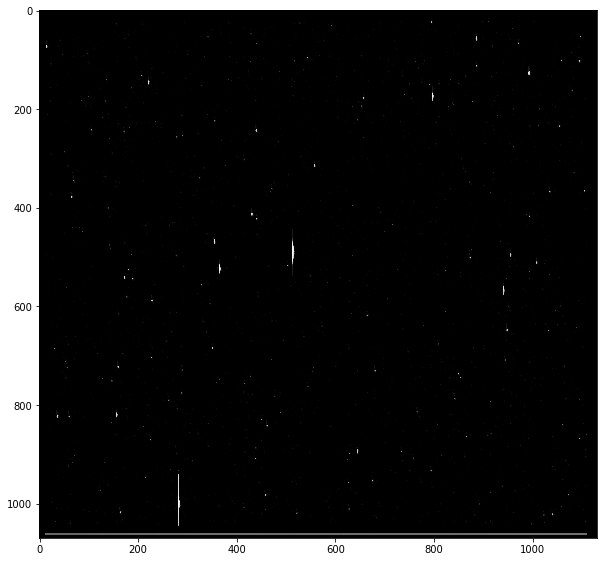

In [64]:
hdu_list = fits.open(medianDir+'median_{}.fits'.format(84))
image_data = hdu_list[0].data
fig, ax = plt.subplots(figsize=(10, 10))
norm = ImageNormalize(stretch=SqrtStretch())
ax.imshow(image_data,cmap='gray') #,norm=LogNorm())
plt.show()

In [ ]:
hdu_list = fits.open()

xoff, yoff, exoff, eyoff = chi2_shift(image, offset_image, noise,return_error=True, upsample_factor='auto')
corrected_image2 = shift.shiftnd(offset_image, -yoff, -xoff)

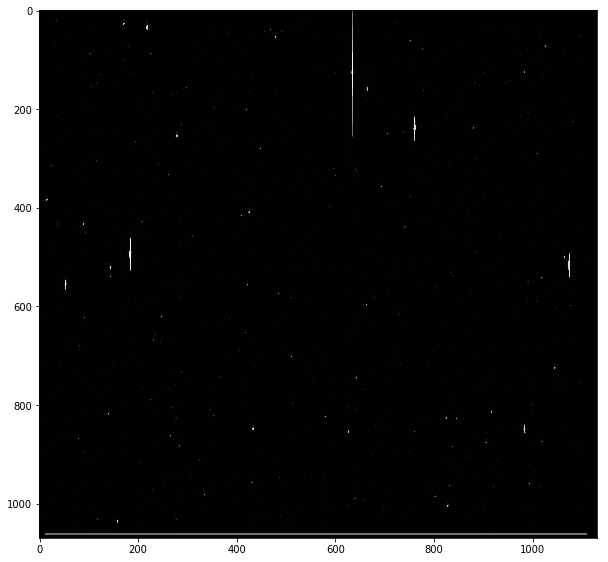

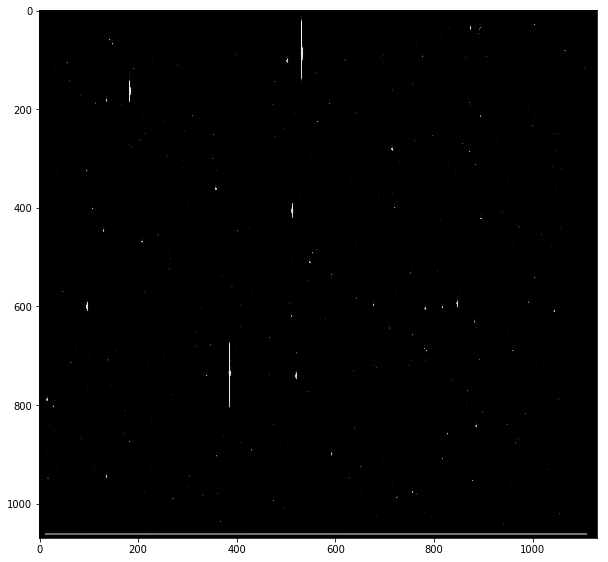

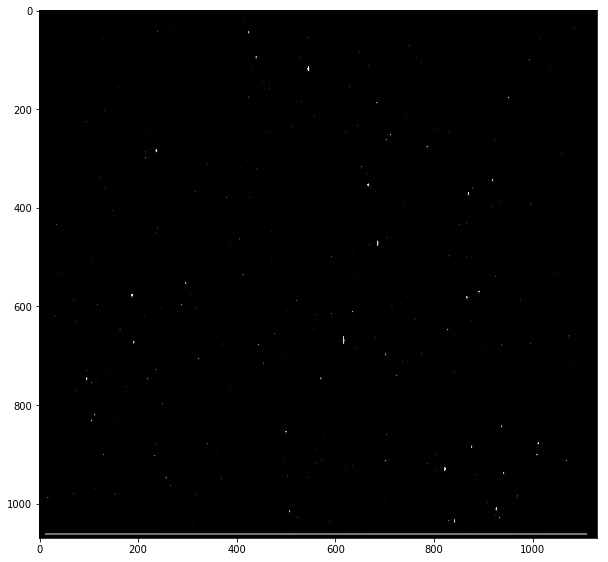

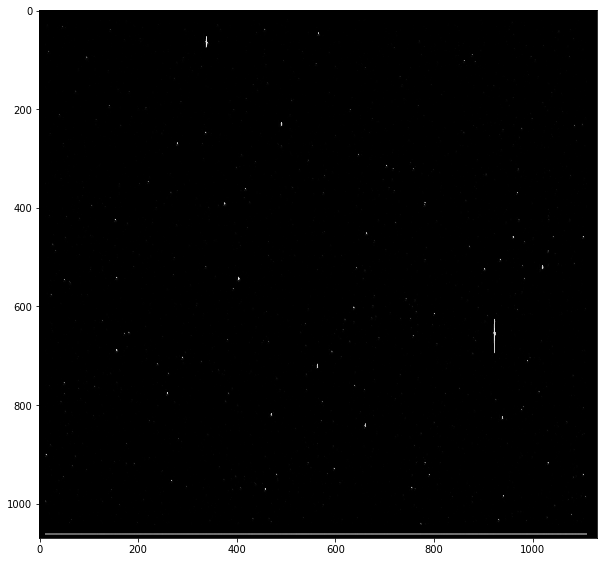

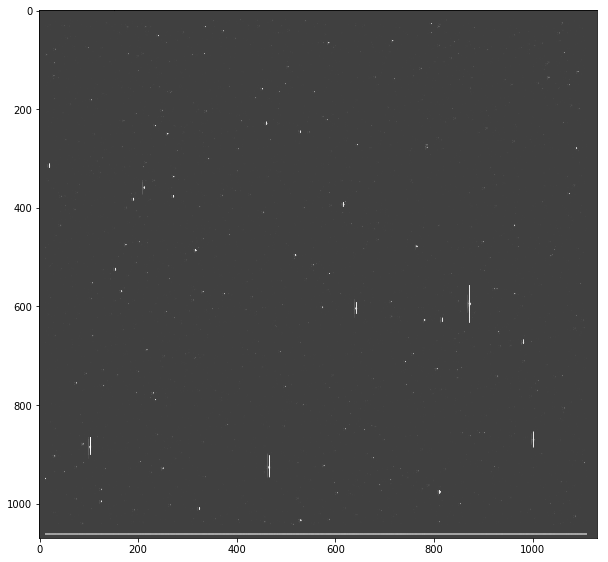

...

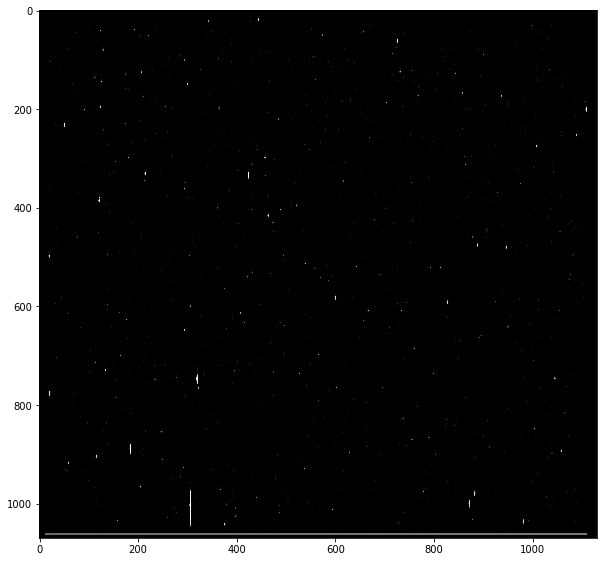

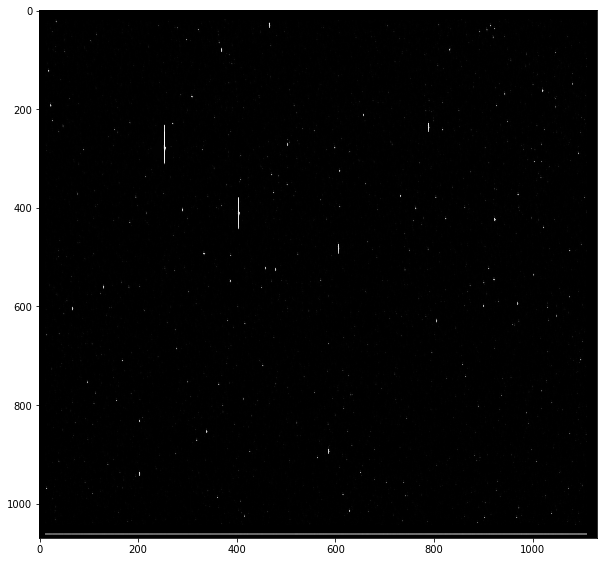

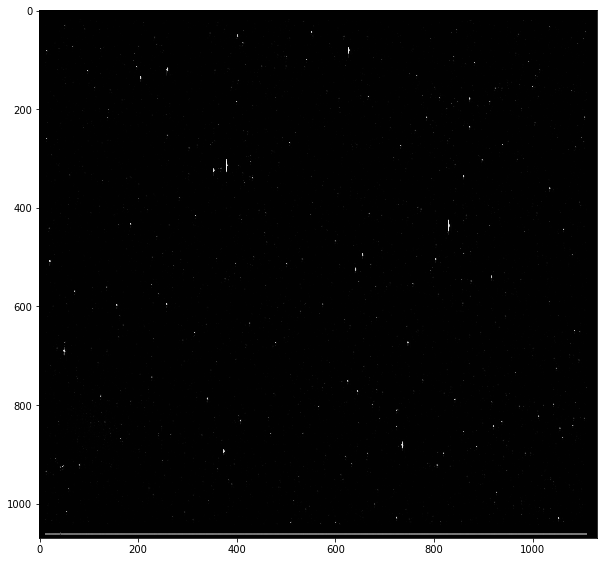

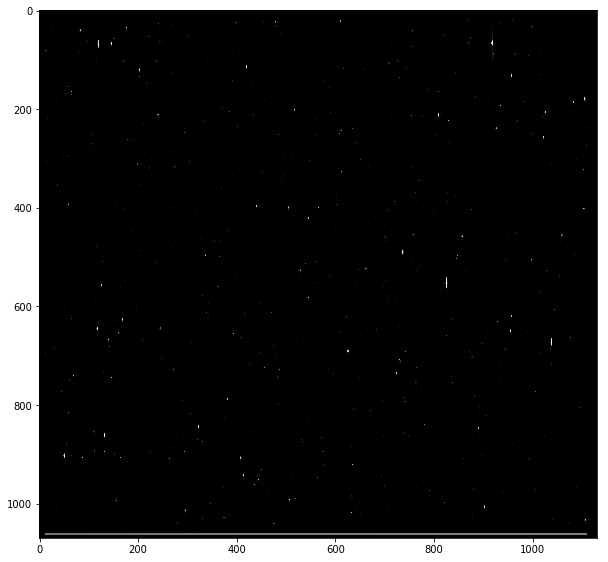

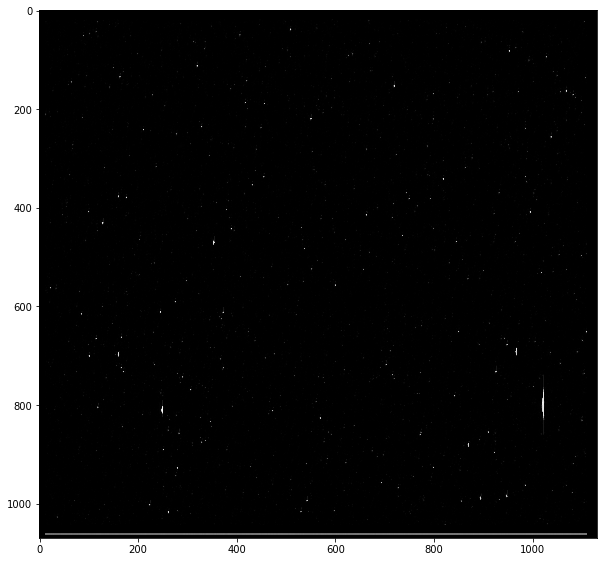

In [52]:
for x in range(1,84):
    hdu_list = fits.open(medianDir+'median_{}.fits'.format(x))
    image_data = hdu_list[0].data
    fig, ax = plt.subplots(figsize=(10, 10))
    norm = ImageNormalize(stretch=SqrtStretch())
    ax.imshow(image_data,cmap='gray') #,norm=LogNorm())
    plt.show()

hdu_list = fits.open(imageDirectory+'kplr2012121122500_ffi-cal.fits')
imagelist = [imageDirectory+x for x in dirlist]
image_concat = []

worldCoord = []

pixCoord = [[225.74692620879759, 22.373711803479079],
 [679.6088620984832, 21.899032630630138],
 [33.923635177493303, 24.208083092179436]]

for ccd in range(1,2): #,len(hdu_list)):
    for image in imagelist:
        hdu_list = fits.open(image)
        worldCoord.append(wcs.WCS(hdu_list[0].header))
        pixcrd = np.array(pixCoord, dtype=np.float_)
        world = w.wcs_pix2world(pixcrd, 1)
        
        image_data = hdu_list[ccd].data
        image_concat.append(image_data)
    final_image = np.sum(image_concat,axis=0)
    median_image = np.median(image_concat,axis=0)
    

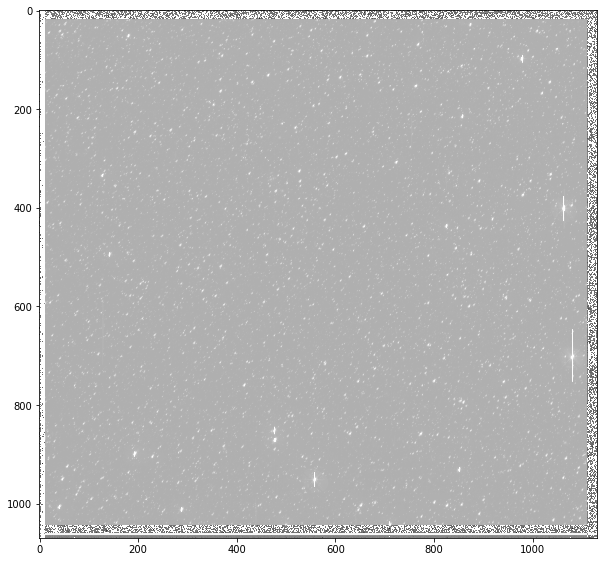

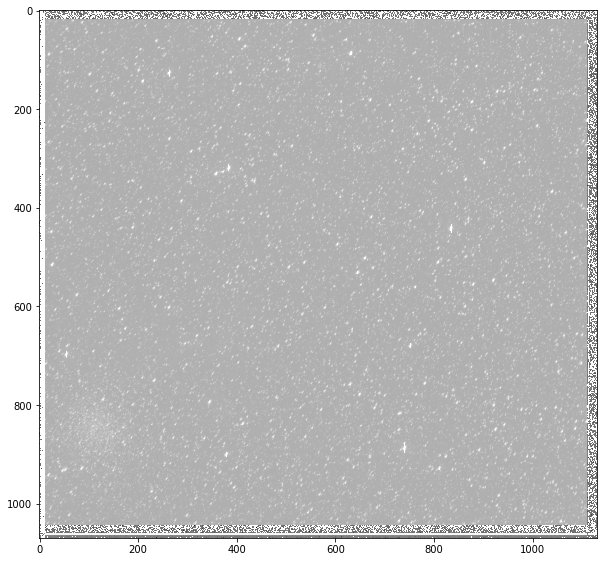

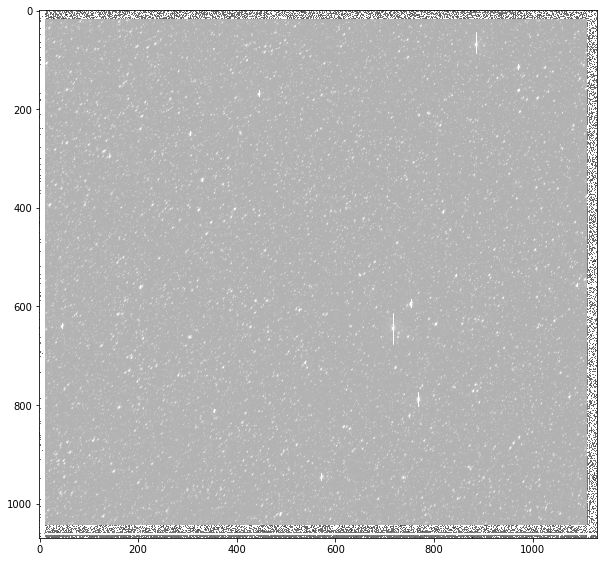

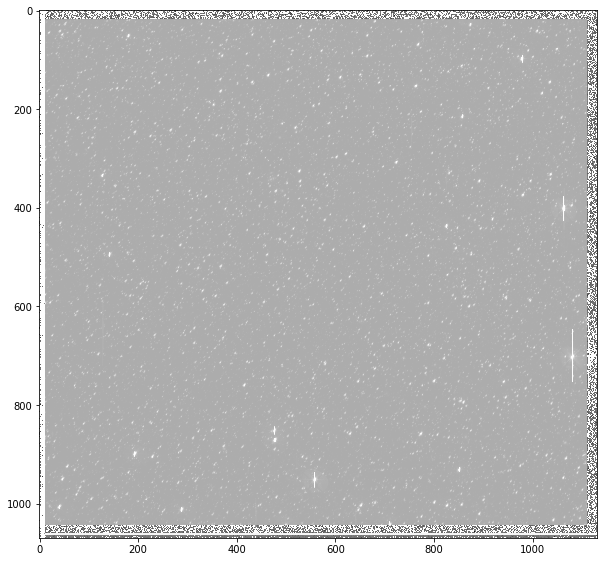

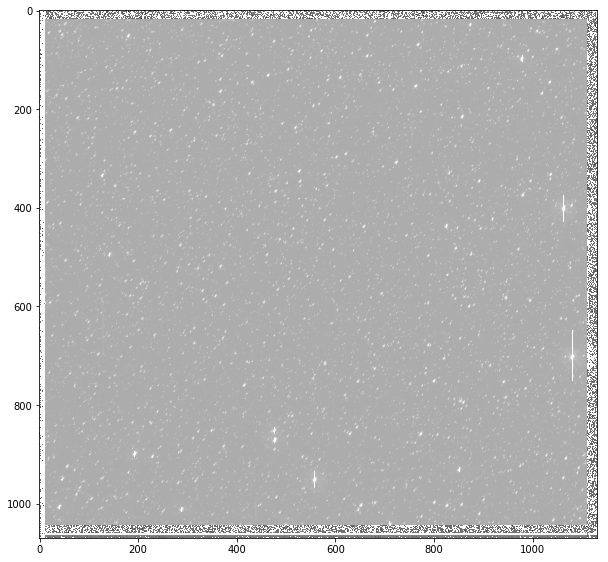

...

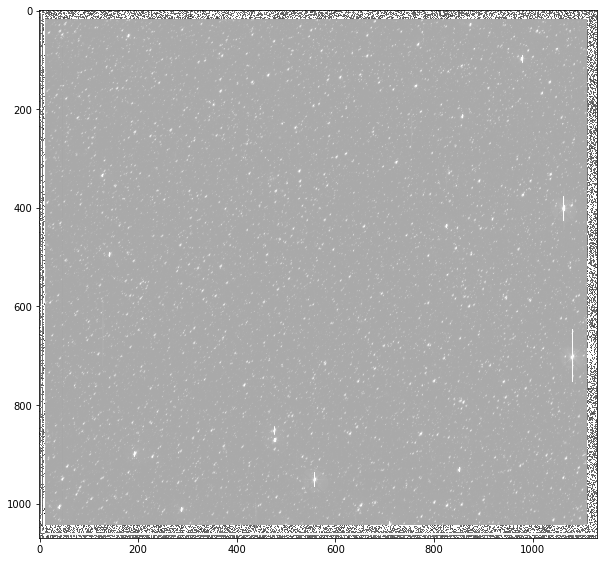

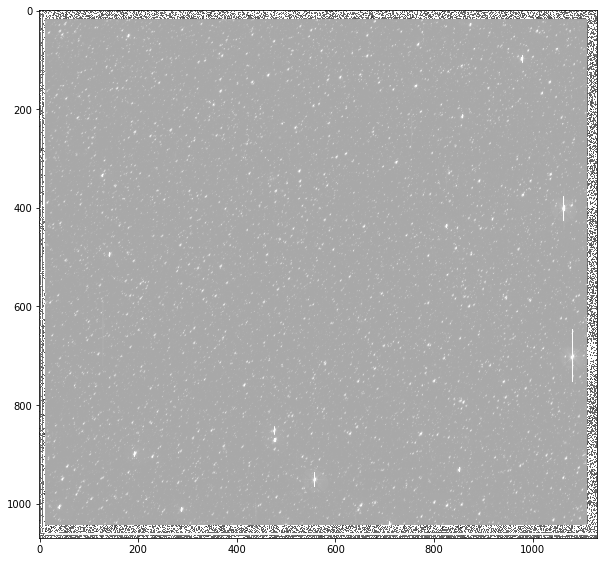

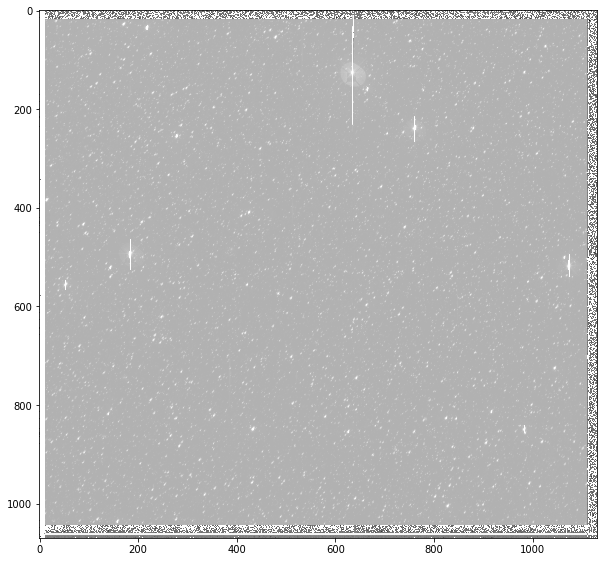

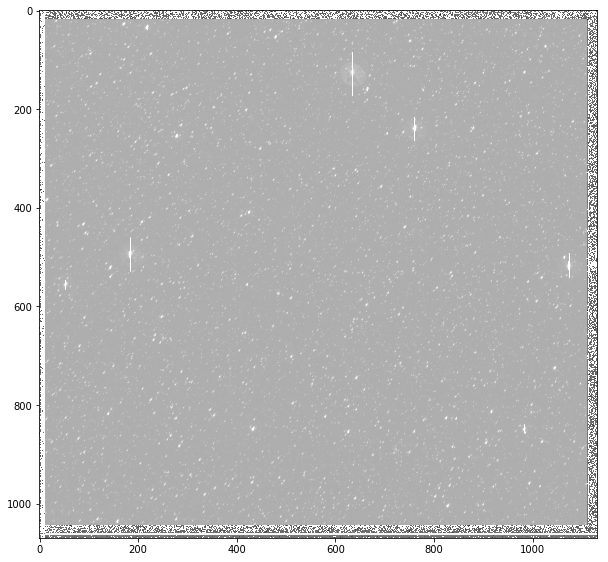

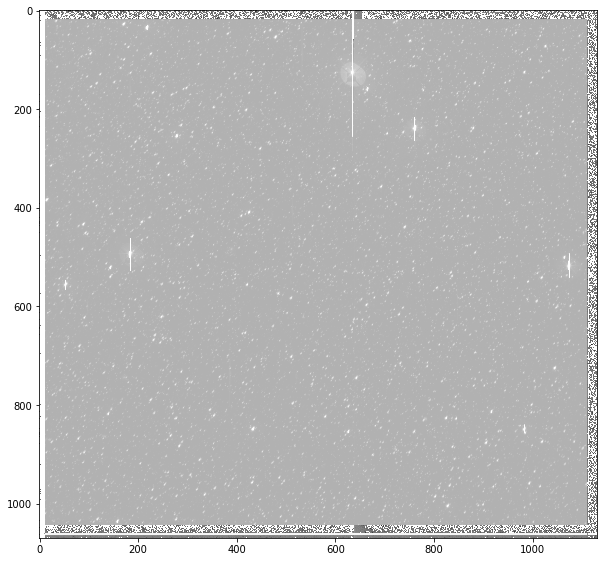

In [43]:
for x in range(len(image_concat)):
    fig, ax = plt.subplots(figsize=(10, 10))

    ax.imshow(image_concat[x],cmap='gray',norm=LogNorm())
    plt.show()
# plt.imshow(final_image,cmap='gray',norm=LogNorm())
# plt.show()
# plt.imshow(median_image,cmap='gray',norm=LogNorm())
# plt.show()

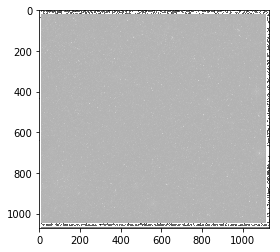

In [37]:
plt.imshow(median_image,cmap='gray',norm=LogNorm())
plt.show()

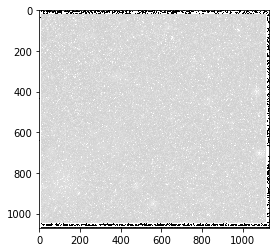

In [38]:
plt.imshow(median_image,cmap='gray',norm=LogNorm(),vmin=1,vmax=500)
plt.show()

In [28]:
outfile = '/home/mj1e16/medianTest2.fits'
hdu = fits.PrimaryHDU(median_image)
hdu.writeto(outfile) #,clobber=True)

In [19]:
median_image

array([ -3.83769141e+04,  -1.16514600e+03,  -2.29910088e+00, ...,
        -4.57241058e+00,  -4.17800617e+00,  -5.82978582e+00], dtype=float32)

In [17]:
#final_image = np.zeros(shape=image_concat[0].shape)
## add stacked images and median
for ccd in range(1): #len(image_concat)):
    final_image = np.sum(image_concat,axis=0)
    median_image = np.median(final_image,axis=0)
    plt.imshow(median_image,cmap='grey',norm=LogNorm())
    plt.show()
    
    


ValueError: Colormap grey is not recognized. Possible values are: Accent, Accent_r, Blues, Blues_r, BrBG, BrBG_r, BuGn, BuGn_r, BuPu, BuPu_r, CMRmap, CMRmap_r, Dark2, Dark2_r, GnBu, GnBu_r, Greens, Greens_r, Greys, Greys_r, OrRd, OrRd_r, Oranges, Oranges_r, PRGn, PRGn_r, Paired, Paired_r, Pastel1, Pastel1_r, Pastel2, Pastel2_r, PiYG, PiYG_r, PuBu, PuBuGn, PuBuGn_r, PuBu_r, PuOr, PuOr_r, PuRd, PuRd_r, Purples, Purples_r, RdBu, RdBu_r, RdGy, RdGy_r, RdPu, RdPu_r, RdYlBu, RdYlBu_r, RdYlGn, RdYlGn_r, Reds, Reds_r, Set1, Set1_r, Set2, Set2_r, Set3, Set3_r, Spectral, Spectral_r, Vega10, Vega10_r, Vega20, Vega20_r, Vega20b, Vega20b_r, Vega20c, Vega20c_r, Wistia, Wistia_r, YlGn, YlGnBu, YlGnBu_r, YlGn_r, YlOrBr, YlOrBr_r, YlOrRd, YlOrRd_r, afmhot, afmhot_r, autumn, autumn_r, binary, binary_r, bone, bone_r, brg, brg_r, bwr, bwr_r, cool, cool_r, coolwarm, coolwarm_r, copper, copper_r, cubehelix, cubehelix_r, flag, flag_r, gist_earth, gist_earth_r, gist_gray, gist_gray_r, gist_heat, gist_heat_r, gist_ncar, gist_ncar_r, gist_rainbow, gist_rainbow_r, gist_stern, gist_stern_r, gist_yarg, gist_yarg_r, gnuplot, gnuplot2, gnuplot2_r, gnuplot_r, gray, gray_r, hot, hot_r, hsv, hsv_r, inferno, inferno_r, jet, jet_r, magma, magma_r, nipy_spectral, nipy_spectral_r, ocean, ocean_r, pink, pink_r, plasma, plasma_r, prism, prism_r, rainbow, rainbow_r, seismic, seismic_r, spectral, spectral_r, spring, spring_r, summer, summer_r, tab10, tab10_r, tab20, tab20_r, tab20b, tab20b_r, tab20c, tab20c_r, terrain, terrain_r, viridis, viridis_r, winter, winter_r